This script clusters the different features and representations exported from .feature_extraction.ipynb.

1) Nearest neighbour graphs of all representations are created based on euclidian distance
2) Embeddings are created using **UMAP** and **Hopkins** statistic computed for each embeddings- and original feature space
3) The following three clustering algorithms are applied:
    - **kMeans**
    - **HDBSCAN**
    - **Leiden**
4) All resulting clusterings are evaluated with
    - **silhouette score**
    - **V-measure**

In [2]:
from copy import deepcopy
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import json
import random

import umap
from umap.umap_ import nearest_neighbors

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder

from utils import plotting, clustering
import pickle

In [3]:
inner = {
    "dataset": [],
    "nn_graph": {},
    "embeddings": [],
    "kMeans": [],
    "kMeans-preset": [],
    "HDBSCAN": [],
    "Leiden": [],    
    "Modularity": []
    }

In [4]:
clusters_dict = {
    "true_labels": [],
    "PAFs": deepcopy(inner),
    "LFCCs": deepcopy(inner),
    "Spectrograms": deepcopy(inner),
    "VAE representations": deepcopy(inner),
    }

In [5]:
RANDOM_SEED = 42
random.seed(RANDOM_SEED)
np.random.RandomState(RANDOM_SEED)

# for permutations
random_seeds = np.random.randint(0, 1000, 10)
print(random_seeds)


SUBSET_SIZE = 95 # size of random subset per class
N_NEIGHBORS = 15 # for nearest neighbors graph
DISTANCE_METRIC = "manhattan"

[102 435 860 270 106  71 700  20 614 121]


In [6]:
# List of titles for plots of PAFs
feature_titles_list = [
    "Duration [s]",
    "Temporal 1st Quartile [s]", 
    "Temporal Median [s]", 
    "Temporal 3rd Quartile [s]", 
    "Temporal Standard Deviation [s]", 
    "Temporal Skewness", 
    "Temporal Kurtosis", 
    "Temporal Entropy", 
    "Mean Frequency [kHz]",
    "Mean Peak Frequency [kHz]",
    "Spectral Sandard Deviation [kHz]",
    "Spectral Flatness", 
    "Frequency 1st Quartile [kHz]",
    "Frequency Median [kHz]", 
    "Frequency 3rd Quartile [kHz]", 
    "Mean Dominant Frequency [kHz]", 
    "Min Dominant Frequency [kHz]",
    "Max Dominant Frequency [kHz]", 
    "Dominant Frequency Range [kHz]", 
    "Dominant Frequency Modulation [kHz]", 
    "Spectral Entropy", 
    "Harmonics-to-Noise Ratio [dB]",
    "Spectrographic Entropy"
    ]

# List of column names of PAFs
feature_columns_list = [
    "duration",
    "t_q1", 
    "t_median", 
    "t_q3", 
    "std_t", 
    "skew_t", 
    "kurt_t", 
    "t_entropy", 
    "mean_f",
    "mean_peak_f", 
    "std_f",
    "flatness_s", 
    "f_q1",
    "f_median", 
    "f_q3", 
    "mean_dom", 
    "min_dom",
    "max_dom", 
    "range_dom", 
    "mod_dom", 
    "pse", 
    "hnr",
    "spectrographic_entropy"
    ]

## Import data

In [7]:
calls_df = pd.read_csv('pickles_and_csvs/features_and_spectrograms.csv')
calls_df['log_padded_spectrogram'] = calls_df['log_padded_spectrogram'].apply(lambda x: np.array(json.loads(x)))
calls_df['log_padded_log_freq_spectrogram'] = calls_df['log_padded_log_freq_spectrogram'].apply(lambda x: np.array(json.loads(x)))
calls_df['log_padded_lfccs'] = calls_df['log_padded_lfccs'].apply(lambda x: np.asarray(json.loads(x)))

In [8]:
# import latent reps from VAE and merge with calls df
representations_df = pd.read_csv("pickles_and_csvs/latent_representations_CVAE.csv")
representations_df["latent_representation"] = representations_df["latent_representation"].apply(lambda x: np.asarray(json.loads(x)))
calls_df = pd.merge(calls_df, representations_df, on="clip_ID")
calls_df = calls_df.drop(columns=["call_type_y"])
calls_df = calls_df.rename(columns={"call_type_x": "call_type"})

In [9]:
print(len(calls_df[calls_df.isna().any(axis=1)]))
calls_df = calls_df.dropna()
calls_df.info()

0
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7282 entries, 0 to 7281
Data columns (total 38 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   track_ID                         7282 non-null   object 
 1   clip_ID                          7282 non-null   object 
 2   goose_ID                         7282 non-null   object 
 3   call_type                        7282 non-null   object 
 4   waveform                         7282 non-null   object 
 5   sr                               7282 non-null   int64  
 6   filepath                         7282 non-null   object 
 7   log_scaled_spectrogram           7282 non-null   object 
 8   lfccs                            7282 non-null   object 
 9   peak                             7282 non-null   float64
 10  duration                         7282 non-null   float64
 11  log_padded_spectrogram           7282 non-null   object 
 12  log_padded_log_fre

/var/folders/kl/qgqbw3bd42bf_tybhvnz9vxh0000gn/T/ipykernel_1591/1510808998.py:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  hist = sns.histplot(


[]

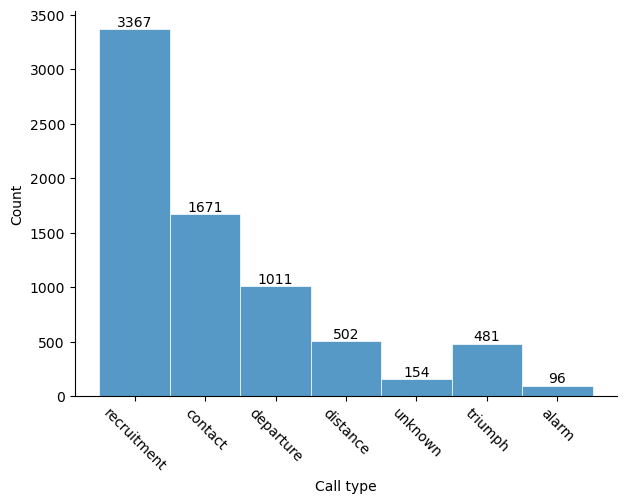

In [10]:
f, ax = plt.subplots(figsize=(7, 5))
sns.despine(f)

hist = sns.histplot(
    calls_df,
    x="call_type",
    multiple="stack",
    palette="viridis",
    edgecolor="1",
    linewidth=.5,
)

plt.xticks(rotation=-45)
ax.set_xlabel("Call type")

# Add counts
for p in hist.patches:
    height = p.get_height()
    x = p.get_x() + p.get_width() / 2
    ax.annotate(f'{int(height)}', (x, height), ha='center', va='bottom')
    
plt.plot()

Only keep a random subset of recruitment, departure and contact calls to balance the dataset and prevent overcrowding the visualizations.

In [11]:
subsample_sizes = {
    'recruitment': SUBSET_SIZE,
    'contact': SUBSET_SIZE,
    'departure': SUBSET_SIZE,
    'distance': SUBSET_SIZE,
    'triumph': SUBSET_SIZE,
    'alarm': SUBSET_SIZE,
    'unknown': 0,
}

# Randomly subsample per call type
def subsample_group(group):
    call_type = group.name  # Group name corresponds to call type
    if call_type in subsample_sizes:
        return group.sample(n=subsample_sizes[call_type], random_state=42)
    return group  # Return untouched if no subsampling is needed

# Group by type and apply subsampling
calls_df = calls_df.groupby('call_type', group_keys=False).apply(subsample_group)

/var/folders/kl/qgqbw3bd42bf_tybhvnz9vxh0000gn/T/ipykernel_1591/1937389859.py:19: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  calls_df = calls_df.groupby('call_type', group_keys=False).apply(subsample_group)


/var/folders/kl/qgqbw3bd42bf_tybhvnz9vxh0000gn/T/ipykernel_1591/1510808998.py:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  hist = sns.histplot(


[]

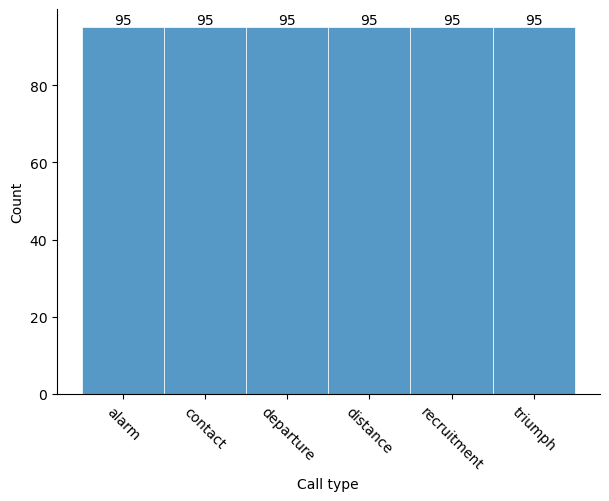

In [12]:
f, ax = plt.subplots(figsize=(7, 5))
sns.despine(f)

hist = sns.histplot(
    calls_df,
    x="call_type",
    multiple="stack",
    palette="viridis",
    edgecolor="1",
    linewidth=.5,
)

plt.xticks(rotation=-45)
ax.set_xlabel("Call type")

# Add counts
for p in hist.patches:
    height = p.get_height()
    x = p.get_x() + p.get_width() / 2
    ax.annotate(f'{int(height)}', (x, height), ha='center', va='bottom')
    
plt.plot()

In [13]:
le = LabelEncoder()
le.fit(calls_df["call_type"])
calls_df["encoded_call_type"] = le.transform(calls_df["call_type"])
clusters_dict["true_labels"] = np.asarray(calls_df["encoded_call_type"])

#### Load representation arrays

In [14]:
# considering scaling: https://github.com/lmcinnes/umap/issues/66

In [15]:
paf_scaled = StandardScaler().fit_transform(calls_df.drop(columns=["call_type", "track_ID", "clip_ID", "goose_ID", "waveform", "sr", "filepath", "log_scaled_spectrogram", "log_padded_spectrogram", "log_padded_log_freq_spectrogram", "lfccs", "log_padded_lfccs", "latent_representation", "duration_paf"]))

In [16]:
def create_representations_subdf_and_scale(full_df, column_name, column_names=["call_type", "track_ID", "goose_ID"]):
    column_names_new_df = column_names.copy()
    subset_list = []
    for idx, row in full_df.iterrows():
        subset_list.append([row["call_type"], row["track_ID"], row["goose_ID"], *row[column_name].flatten()])

    for i in range(len(full_df.iloc[0][column_name].flatten())):
        column_names_new_df.append(i)

    subset_df = pd.DataFrame(subset_list, columns=column_names_new_df, index=None)
    subset_df.head()

    subset_scaled = StandardScaler().fit_transform(subset_df.drop(columns=column_names))

    return subset_scaled, subset_df

In [17]:
lfccs_scaled, lfccs_df = create_representations_subdf_and_scale(calls_df, "log_padded_lfccs", column_names=["call_type", "track_ID", "goose_ID"])
lfccs_df.head()

,call_type,track_ID,goose_ID,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,...,7064,7065,7066,7067,7068,7069,7070,7071,7072,7073,7074,7075,7076,7077,7078,7079,7080,7081,7082,7083,7084,7085,7086,7087,7088,7089,7090,7091,7092,7093,7094,7095,7096,7097,7098,7099,7100,7101,7102,7103
0,alarm,GT00989,unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.332172,0.404361,0.516783,0.552547,0.569241,0.618329,0.640536,0.665247,0.791363,0.765597,0.770387,0.775047,0.787834,0.771263,...,0.784032,0.789495,0.793950,0.782265,0.786145,0.793709,0.801123,0.794779,0.794785,0.792109,0.794464,0.79825,0.790571,0.79453,0.795229,0.796151,0.799122,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,alarm,GT00988,unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.073353,0.118315,0.162820,0.210330,0.275056,0.323045,0.371326,...,0.717170,0.722711,0.728425,0.733736,0.736251,0.732363,0.732298,0.736851,0.728885,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,alarm,GT00988,unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.718984,0.724985,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,alarm,GT00988,unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.298525,0.336660,...,0.739191,0.745222,0.746229,0.744777,0.749317,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,alarm,GT00058,Besenstiel,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.116940,0.178032,0.217399,0.255978,0.279021,0.348806,0.394797,...,0.635669,0.642113,0.633917,0.645416,0.645984,0.645250,0.643610,0.648962,0.646554,0.643358,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [18]:
spectrograms_scaled, spectrograms_df = create_representations_subdf_and_scale(calls_df, "log_padded_spectrogram", column_names=["call_type", "track_ID", "goose_ID"])
spectrograms_df.head()

,call_type,track_ID,goose_ID,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,...,7440,7441,7442,7443,7444,7445,7446,7447,7448,7449,7450,7451,7452,7453,7454,7455,7456,7457,7458,7459,7460,7461,7462,7463,7464,7465,7466,7467,7468,7469,7470,7471,7472,7473,7474,7475,7476,7477,7478,7479
0,alarm,GT00989,unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.106813,0.078841,0.007484,0.02056,0.050403,0.024058,0.019514,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,alarm,GT00988,unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,alarm,GT00988,unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,alarm,GT00988,unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,alarm,GT00058,Besenstiel,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [19]:
_, vae_df = create_representations_subdf_and_scale(calls_df, "latent_representation", column_names=["call_type", "track_ID", "goose_ID"])
vae_df.head()

,call_type,track_ID,goose_ID,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,...,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127
0,alarm,GT00989,unknown,-0.944060,-0.570308,0.098884,0.010787,0.076851,-3.068983,-3.963550,-2.652780,0.766620,-1.785648,-1.978041,2.384170,-0.711418,0.480081,0.676422,3.508663,1.120349,0.944472,1.188966,-0.289816,-4.903134,0.690356,-1.749212,1.030354,-1.716122,-2.402162,2.100998,-0.891684,-2.731004,0.989038,0.729544,-1.733990,3.139920,0.463553,-2.426979,1.096734,-1.322383,...,4.133445,0.748676,0.190568,-3.686912,-1.744402,1.890660,-2.733474,-1.525612,-3.039372,0.929953,0.915257,-0.321135,0.704935,2.419378,-3.117693,0.429076,1.799334,1.165084,-1.387330,-1.993918,-1.310476,-0.168115,0.715093,-3.749794,1.671615,1.273414,-1.292664,-0.230836,-1.418980,-0.185079,0.802787,2.268884,-1.051697,-0.188516,-0.500350,0.428090,-2.137242,0.387635,1.839603,0.845892
1,alarm,GT00988,unknown,-0.956943,-1.773930,0.384466,-2.134551,0.078547,-1.172719,-2.774652,-1.146500,0.548819,-2.088976,-1.275886,2.212194,0.133267,-0.474213,0.356943,2.542998,0.525941,1.132599,0.468459,0.497693,-5.552773,1.163044,-2.464014,1.430791,-2.255168,-0.994194,0.922115,-1.143036,-1.371813,0.947902,1.227422,-1.531996,3.202591,0.095062,-2.107558,2.226111,-2.315388,...,4.018793,0.898309,0.238040,-2.199400,-2.414215,2.083203,-3.038870,-1.412850,-2.440926,-0.499351,0.720680,0.762227,-0.168909,1.579903,-3.466048,-0.168867,1.203676,0.380459,-0.198556,-0.569803,-1.728379,-0.379072,0.356999,-3.198261,1.781898,0.961953,-0.410338,0.303100,-0.437402,0.049530,0.714717,2.449260,-0.408718,-0.310165,-1.067806,-1.544384,-2.164551,-1.150056,1.620537,0.197635
2,alarm,GT00988,unknown,0.292569,-0.986353,0.058842,-0.328399,-0.313604,-0.213014,-1.491529,-0.919347,-0.789889,-2.289029,-0.239077,2.572617,0.313995,0.761685,0.344055,1.455518,1.074993,1.038292,0.784264,0.093295,-3.998278,0.868613,-1.129760,1.610877,-1.797028,-1.970963,0.703697,-1.273989,-1.290385,1.038004,0.514821,-0.904798,1.738619,0.758844,-0.922538,1.838959,-2.027554,...,3.262348,0.088681,1.096704,-2.193816,-1.911770,0.896937,-1.246367,-1.408047,-1.974481,0.426328,0.395366,0.279133,-0.196167,1.838079,-2.654200,0.086996,1.502785,0.447044,-0.248072,-0.910756,-1.588131,0.358369,0.239033,-1.799821,1.761451,0.099042,-0.681088,-0.089111,-0.126202,0.195306,0.142658,0.963124,-0.531490,0.244167,-0.867126,-0.779113,-0.574433,0.093889,1.702245,-0.019371
3,alarm,GT00988,unknown,-0.033844,-1.640984,0.518415,-1.744413,-0.881569,-0.706057,-2.173376,-1.171960,-0.569402,-2.168947,-0.207792,2.091016,0.015372,0.203526,0.173416,1.851106,0.979643,1.103685,1.057169,0.532944,-5.105286,-0.252218,-1.940065,0.915220,-1.794819,-1.037300,1.400761,-1.232770,-1.643798,1.396578,0.770588,-1.150708,2.714558,0.399014,-1.648575,2.123255,-2.569024,...,4.248158,-0.100691,0.457777,-2.336184,-1.899788,1.373648,-2.170690,-0.331773,-2.628282,-0.012445,0.428847,0.419935,-0.796939,1.886962,-2.841392,-0.489336,1.994830,0.566852,0.242974,-1.198421,-2.075143,-0.406770,0.714650,-2.163800,1.411632,1.002137,-0.515958,-0.400625,0.167315,0.139373,0.680469,2.642730,-0.697689,0.174886,-1.262820,-1.342448,-1.438641,-0.425008,1.337904,-0.763780
4,alarm,GT00058,Besenstiel,0.190278,-1.640662,0.670751,-1.956163,0.003937,-1.224041,-4.144087,-0.383441,0.492952,-2.389735,-2.122954,1.249209,-0.541684,0.089406,0.448290,2.258691,0.846100,1.037184,1.876388,-0.383773,-5.518841,0.326363,-1.964390,1.860684,-2.269719,-1.527783,1.097527,-1.366493,-0.664614,1.426028,1.750886,-0.161088,3.382288,0.951509,-1.468027,2.273656,-2.666116,...,3.913417,1.150876,0.260946,-3.329940,-1.961448,1.773605,-2.395548,-0.409520,-1.230597,-0.521151,-0.397807,1.929469,-0.321654,1.912864,-3.322169,-0.559320,2.002481,0.429222,0.179368,-1.550155,-1.619756,0.578066,0.602650,-3.321137,1.483264,0.360183,-0.992227,0.236421,-0.152832,-0.357498,0.924560,

# Cluster and validate the different represenations

## NN Graphs and UMAP embeddings

#### Embed predefined audio features

In [20]:
nn_results_paf = nearest_neighbors(
    paf_scaled,
    n_neighbors=N_NEIGHBORS,
    metric=DISTANCE_METRIC,
    metric_kwds={},
    angular=False,
    random_state=RANDOM_SEED,
    verbose=True,
)

clusters_dict["PAFs"]["nn_graph"] = nn_results_paf

Tue Feb 11 10:52:02 2025 Finding Nearest Neighbors
Tue Feb 11 10:52:02 2025 Building RP forest with 6 trees
Tue Feb 11 10:52:05 2025 NN descent for 9 iterations
	 1  /  9
	 2  /  9
	 3  /  9
	 4  /  9
	Stopping threshold met -- exiting after 4 iterations
Tue Feb 11 10:52:13 2025 Finished Nearest Neighbor Search


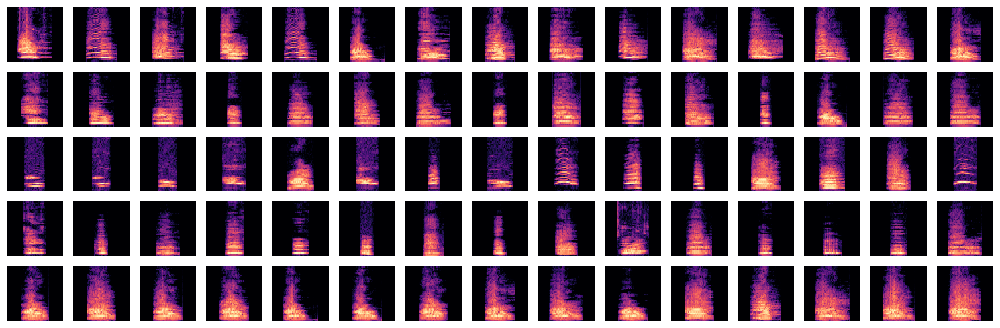

In [21]:
plotting.display_nearest_neighbours(nn_results_paf, calls_df)

In [22]:
embeddings_paf = umap.UMAP(precomputed_knn=nn_results_paf, n_neighbors=15, n_components=2, min_dist=0.1, random_state=RANDOM_SEED).fit_transform(paf_scaled)
clusters_dict["PAFs"]["embeddings"] = embeddings_paf

/Users/lenagies/anaconda3/envs/goose_vocalizations/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


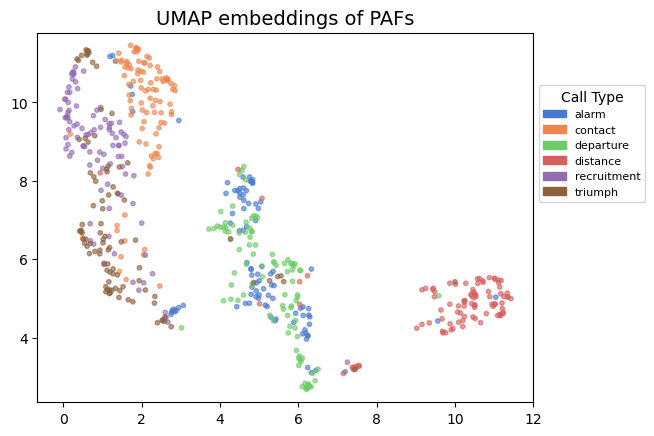

In [23]:
plotting.plot_embeddings_with_colorcoded_label(calls_df, embeddings_paf, "call_type", "UMAP embeddings of PAFs", "Call Type")

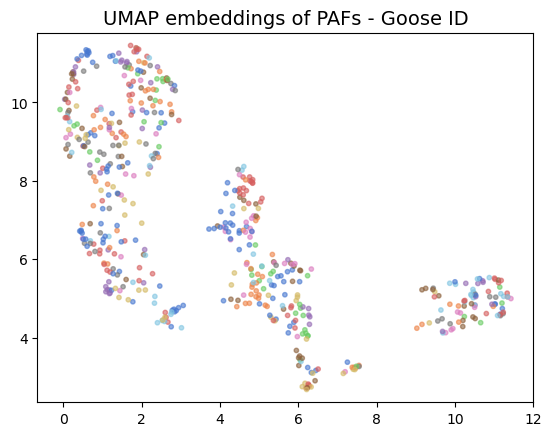

In [24]:
plotting.plot_embeddings_with_colorcoded_label(calls_df, embeddings_paf, "goose_ID", "UMAP embeddings of PAFs - Goose ID", show_legend=False)

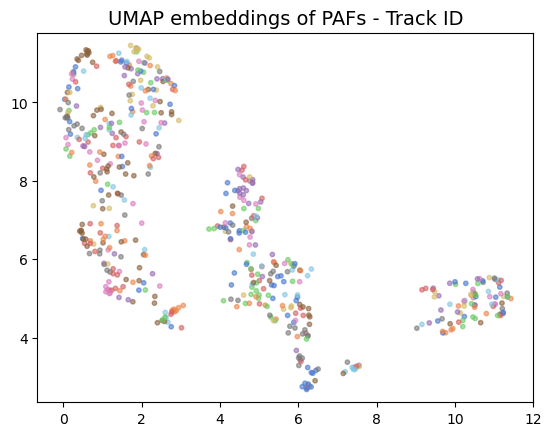

In [25]:
plotting.plot_embeddings_with_colorcoded_label(calls_df, embeddings_paf, "track_ID", "UMAP embeddings of PAFs - Track ID", show_legend=False)

/Users/lenagies/Desktop/Master/Thesis/geese/code/GooseVocalizations/utils/plotting.py:436: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(


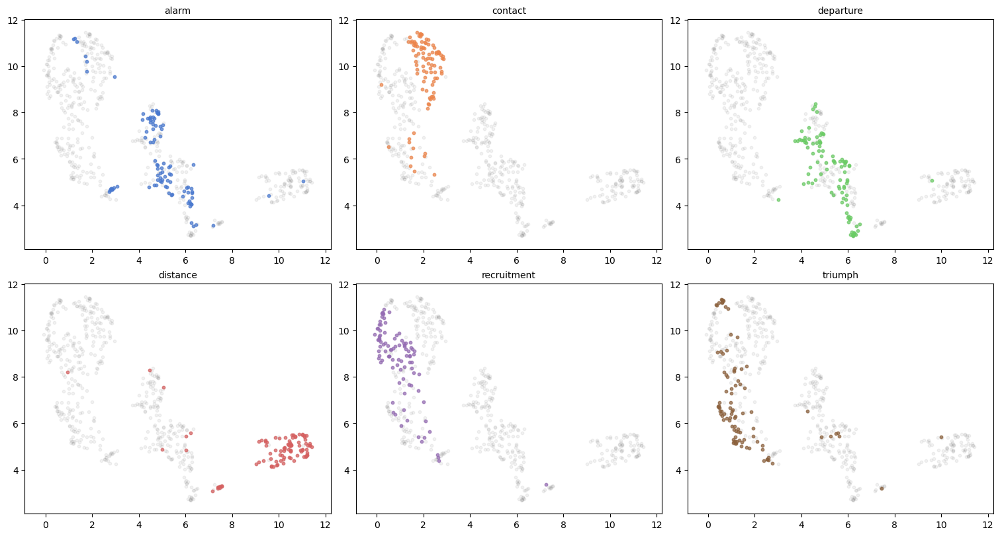

In [26]:
plotting.plot_embedding_per_call_type(embeddings_paf, calls_df)

#### Embed LFCCs

In [27]:
nn_results_lfcc = nearest_neighbors(
    lfccs_scaled,
    n_neighbors=N_NEIGHBORS,
    metric=DISTANCE_METRIC,
    metric_kwds={},
    angular=False,
    random_state=RANDOM_SEED,
    verbose=True,
)
clusters_dict["LFCCs"]["nn_graph"] = nn_results_lfcc

Tue Feb 11 10:52:23 2025 Finding Nearest Neighbors
Tue Feb 11 10:52:23 2025 Building RP forest with 6 trees
Tue Feb 11 10:52:23 2025 NN descent for 9 iterations
	 1  /  9
	 2  /  9
	 3  /  9
	Stopping threshold met -- exiting after 3 iterations
Tue Feb 11 10:52:23 2025 Finished Nearest Neighbor Search


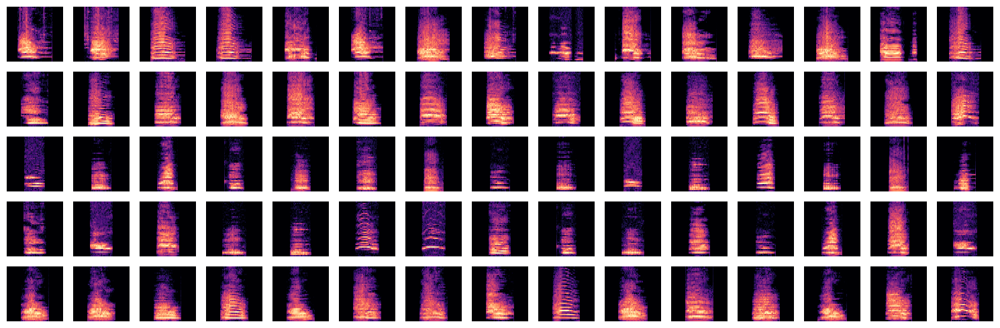

In [28]:
plotting.display_nearest_neighbours(nn_results_lfcc, calls_df)

In [29]:
embeddings_lfcc = umap.UMAP(precomputed_knn=nn_results_lfcc, n_neighbors=N_NEIGHBORS, n_components=2, min_dist=0.1, random_state=RANDOM_SEED).fit_transform(lfccs_scaled)
clusters_dict["LFCCs"]["embeddings"] = embeddings_lfcc

/Users/lenagies/anaconda3/envs/goose_vocalizations/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


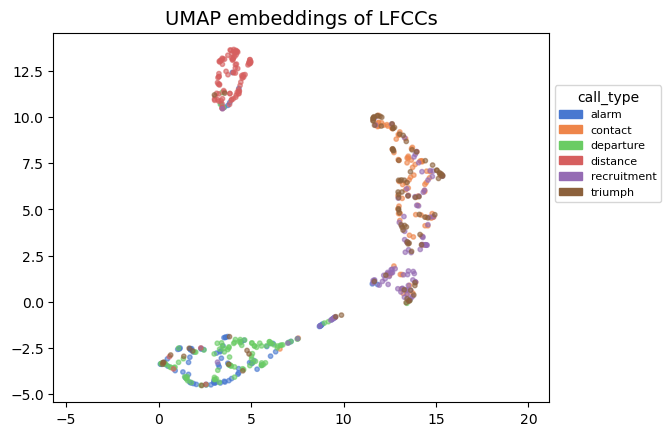

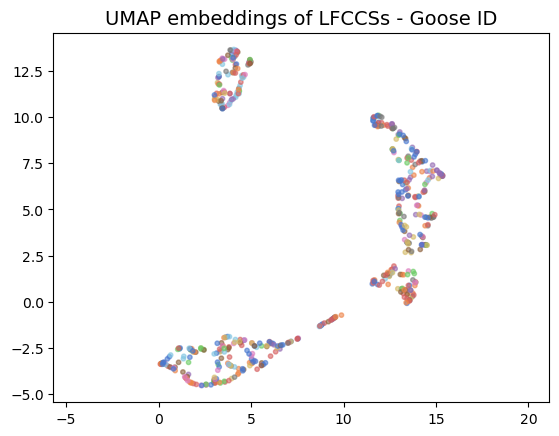

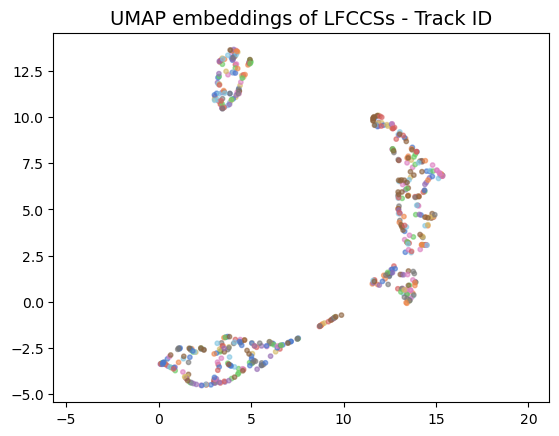

/Users/lenagies/Desktop/Master/Thesis/geese/code/GooseVocalizations/utils/plotting.py:436: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(


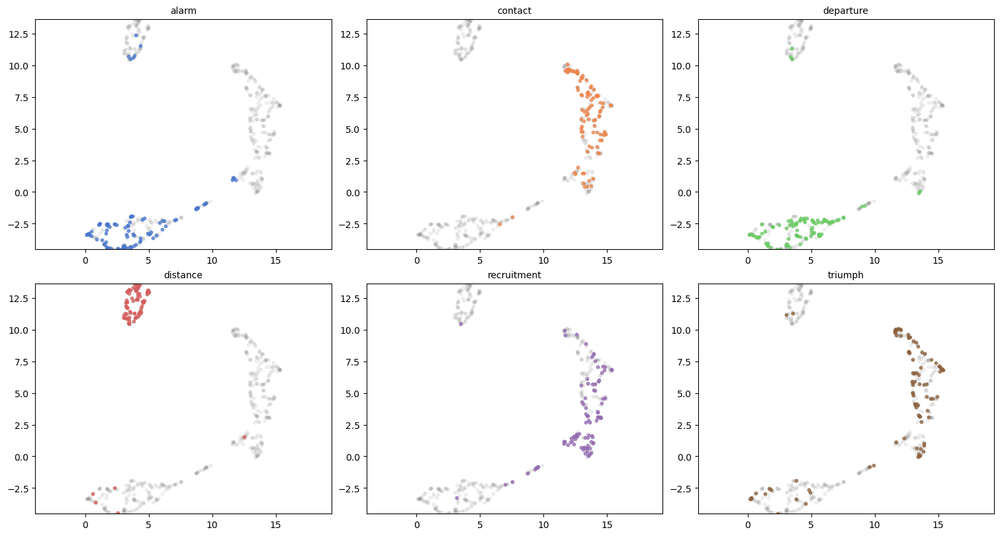

In [30]:
plotting.plot_embeddings_with_colorcoded_label(lfccs_df, embeddings_lfcc, "call_type", "UMAP embeddings of LFCCs")
plotting.plot_embeddings_with_colorcoded_label(lfccs_df, embeddings_lfcc, "goose_ID", "UMAP embeddings of LFCCSs - Goose ID", show_legend=False)
plotting.plot_embeddings_with_colorcoded_label(lfccs_df, embeddings_lfcc, "track_ID", "UMAP embeddings of LFCCSs - Track ID", show_legend=False)
plotting.plot_embedding_per_call_type(embeddings_lfcc, lfccs_df)

#### Embed spectrograms

##### UMAP

In [31]:
nn_results_spec = nearest_neighbors(
    spectrograms_scaled,
    n_neighbors=N_NEIGHBORS,
    metric=DISTANCE_METRIC,
    metric_kwds={},
    angular=False,
    random_state=RANDOM_SEED,
    verbose=True,
)
clusters_dict["Spectrograms"]["nn_graph"] = nn_results_spec

Tue Feb 11 10:52:30 2025 Finding Nearest Neighbors
Tue Feb 11 10:52:30 2025 Building RP forest with 6 trees
Tue Feb 11 10:52:30 2025 NN descent for 9 iterations
	 1  /  9
	 2  /  9
	 3  /  9
	Stopping threshold met -- exiting after 3 iterations
Tue Feb 11 10:52:30 2025 Finished Nearest Neighbor Search


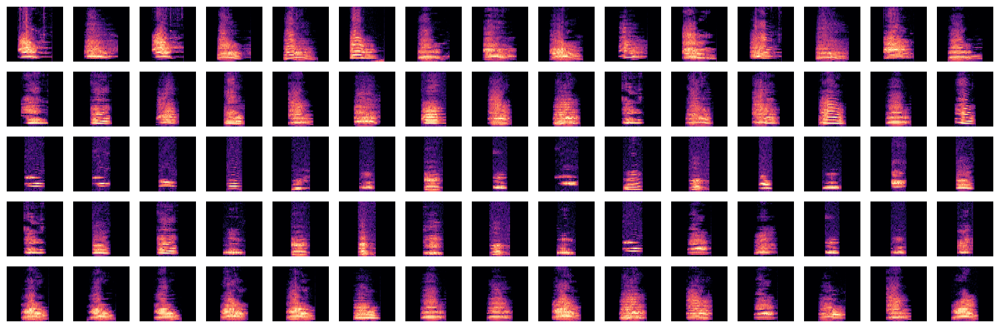

In [32]:
plotting.display_nearest_neighbours(nn_results_spec, calls_df)

In [33]:
embeddings_spec = umap.UMAP(precomputed_knn=nn_results_spec, n_neighbors=N_NEIGHBORS, n_components=2, min_dist=0.1, random_state=RANDOM_SEED).fit_transform(spectrograms_scaled)
clusters_dict["Spectrograms"]["embeddings"] = embeddings_spec

/Users/lenagies/anaconda3/envs/goose_vocalizations/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


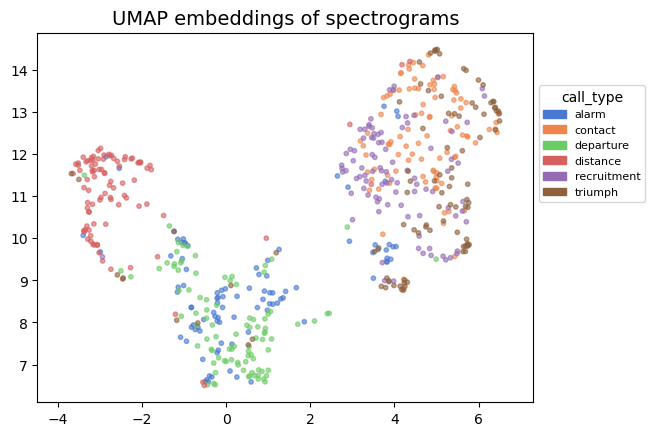

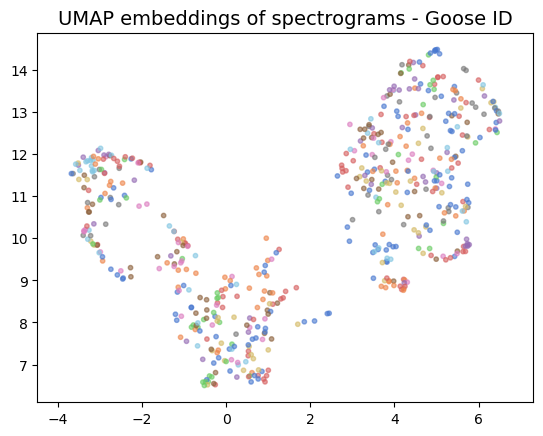

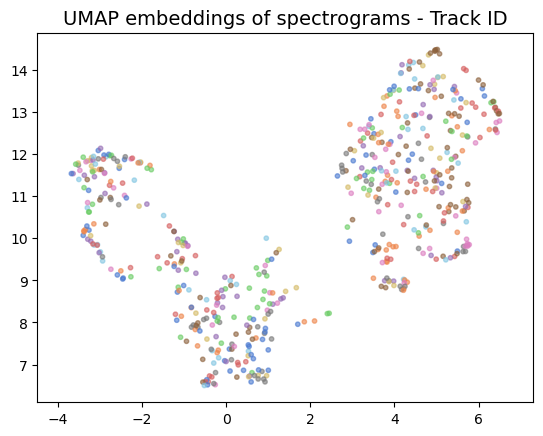

/Users/lenagies/Desktop/Master/Thesis/geese/code/GooseVocalizations/utils/plotting.py:436: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(


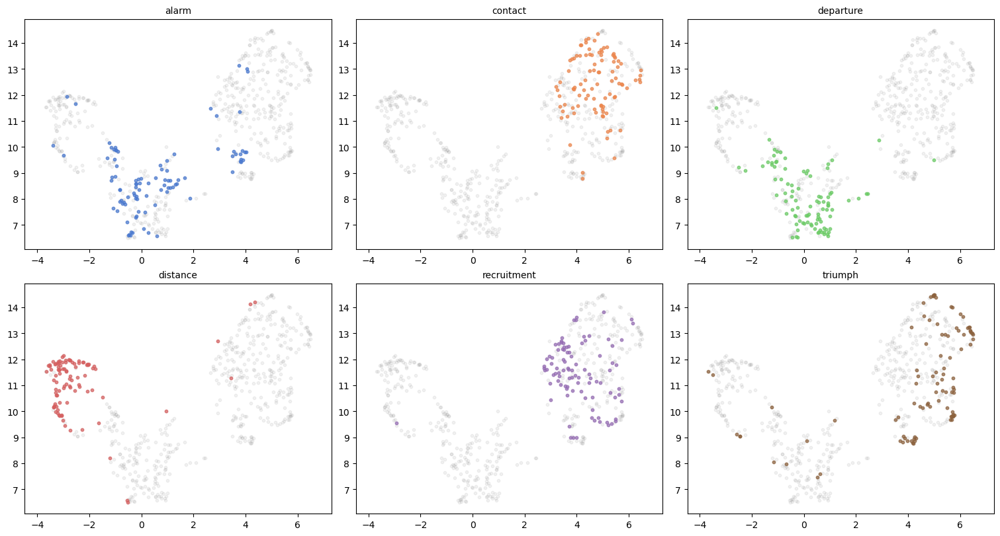

In [34]:
plotting.plot_embeddings_with_colorcoded_label(spectrograms_df, embeddings_spec, "call_type", "UMAP embeddings of spectrograms")
plotting.plot_embeddings_with_colorcoded_label(spectrograms_df, embeddings_spec, "goose_ID", "UMAP embeddings of spectrograms - Goose ID", show_legend=False)
plotting.plot_embeddings_with_colorcoded_label(spectrograms_df, embeddings_spec, "track_ID", "UMAP embeddings of spectrograms - Track ID", show_legend=False)
plotting.plot_embedding_per_call_type(embeddings_spec, spectrograms_df)

#### VAE embeddings

In [35]:
nn_results_vae = nearest_neighbors(
    vae_df.drop(columns=["call_type", "track_ID", "goose_ID"]),
    n_neighbors=N_NEIGHBORS,
    metric=DISTANCE_METRIC,
    metric_kwds={},
    angular=False,
    random_state=RANDOM_SEED,
    verbose=True,
)
clusters_dict["VAE representations"]["nn_graph"] = nn_results_vae

Tue Feb 11 10:52:37 2025 Finding Nearest Neighbors
Tue Feb 11 10:52:37 2025 Building RP forest with 6 trees
Tue Feb 11 10:52:37 2025 NN descent for 9 iterations
	 1  /  9
	 2  /  9
	 3  /  9
	Stopping threshold met -- exiting after 3 iterations
Tue Feb 11 10:52:37 2025 Finished Nearest Neighbor Search


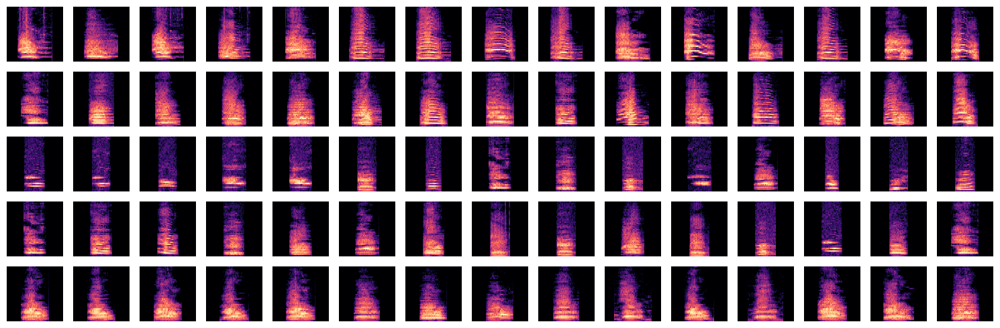

In [36]:
plotting.display_nearest_neighbours(nn_results_vae, calls_df)

In [37]:
embeddings_vae = umap.UMAP(precomputed_knn=nn_results_vae, n_neighbors=N_NEIGHBORS, n_components=2, min_dist=0.1, random_state=RANDOM_SEED).fit_transform(vae_df.drop(columns=["call_type", "track_ID", "goose_ID"]))
clusters_dict["VAE representations"]["embeddings"] = embeddings_vae

/Users/lenagies/anaconda3/envs/goose_vocalizations/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


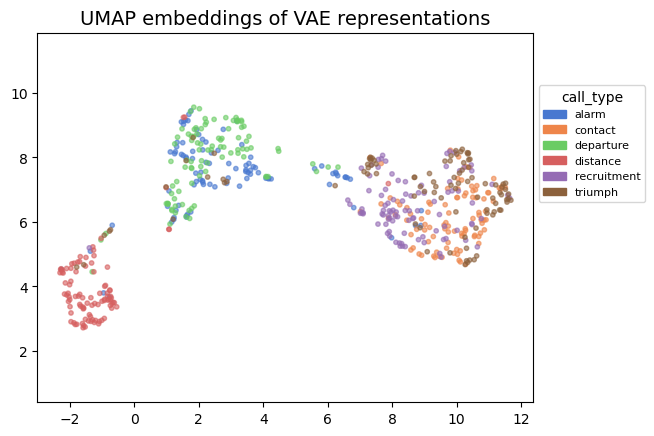

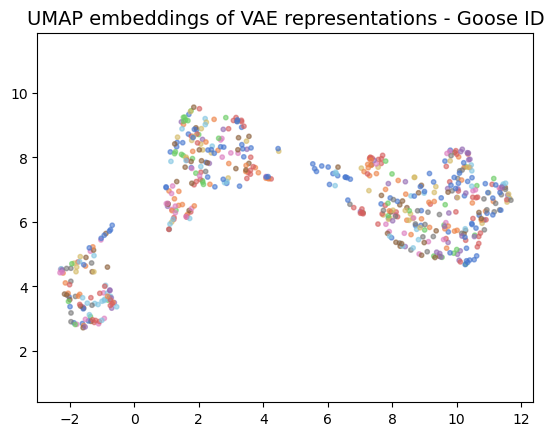

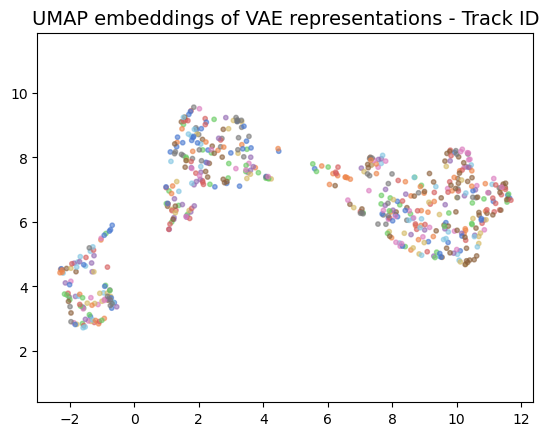

/Users/lenagies/Desktop/Master/Thesis/geese/code/GooseVocalizations/utils/plotting.py:436: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(


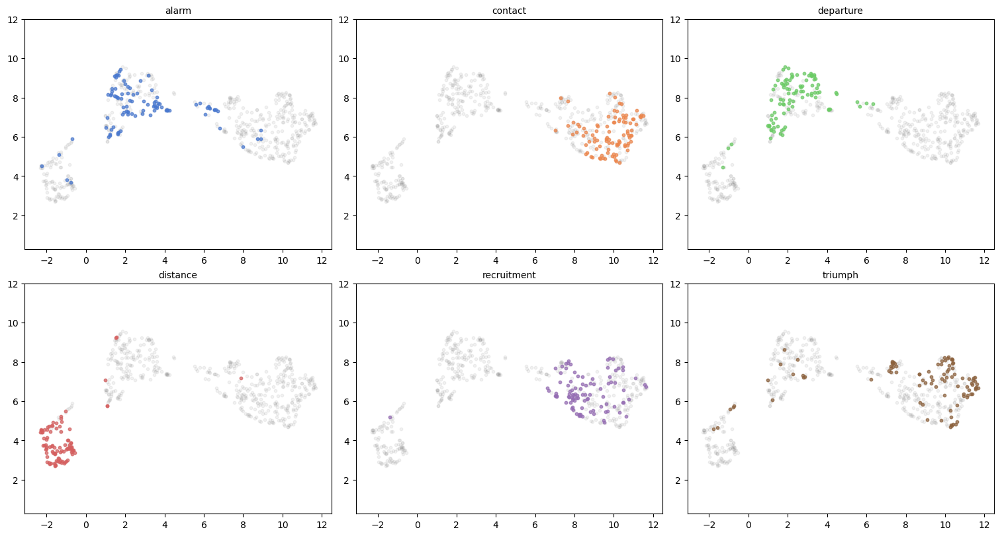

In [38]:
plotting.plot_embeddings_with_colorcoded_label(vae_df, embeddings_vae, "call_type", "UMAP embeddings of VAE representations")
plotting.plot_embeddings_with_colorcoded_label(vae_df, embeddings_vae, "goose_ID", "UMAP embeddings of VAE representations - Goose ID", show_legend=False)
plotting.plot_embeddings_with_colorcoded_label(vae_df, embeddings_vae, "track_ID", "UMAP embeddings of VAE representations - Track ID", show_legend=False)
plotting.plot_embedding_per_call_type(embeddings_vae, vae_df)

## Visualize acoustic features

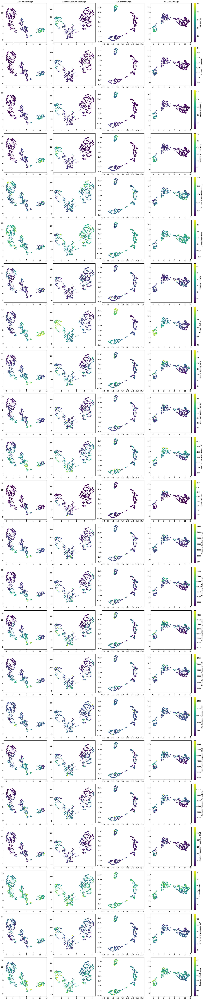

In [39]:
plotting.plot_colorcoded_features(
    feature_columns_list, 
    feature_titles_list, 
    [embeddings_paf, embeddings_spec, embeddings_lfcc, embeddings_vae], 
    ["PAF embeddings", "Spectrogram embeddings", "LFCC embeddings", "VAE embeddings"], 
    calls_df)

## Clustering

#### k-means

In [40]:
print("--------------PAF---------------")

print("\n--------PAF embeddings--------")
_, _, clusters_dict["PAFs"]["kMeans-preset"] = clustering.silhouette_analysis_kmeans(embeddings_paf, random_seeds, range_n_clusters=[6])

print("\n-------LFCC embeddings--------")
_, _, clusters_dict["LFCCs"]["kMeans-preset"] = clustering.silhouette_analysis_kmeans(embeddings_lfcc, random_seeds, range_n_clusters=[6])

print("\n----Spectrogram embeddings----")
_, _, clusters_dict["Spectrograms"]["kMeans-preset"] = clustering.silhouette_analysis_kmeans(embeddings_spec, random_seeds, range_n_clusters=[6])

print("\n----VAE representations embeddings----")
_, _, clusters_dict["VAE representations"]["kMeans-preset"] = clustering.silhouette_analysis_kmeans(embeddings_vae, random_seeds, range_n_clusters=[6])

--------------PAF---------------

--------PAF embeddings--------
For n_clusters = 6 The silhouette_score is: 0.57566476
best score with 6 clusters: 0.575664758682251

-------LFCC embeddings--------
For n_clusters = 6 The silhouette_score is: 0.56948537
best score with 6 clusters: 0.5694853663444519

----Spectrogram embeddings----
For n_clusters = 6 The silhouette_score is: 0.44083393
best score with 6 clusters: 0.4408339262008667

----VAE representations embeddings----
For n_clusters = 6 The silhouette_score is: 0.47102955
best score with 6 clusters: 0.4710295498371124


In [41]:
print("--------------PAF---------------")

print("\n--------PAF embeddings--------")
_, _, clusters_dict["PAFs"]["kMeans"] = clustering.silhouette_analysis_kmeans(embeddings_paf, random_seeds)

print("\n-------LFCC embeddings--------")
_, _, clusters_dict["LFCCs"]["kMeans"] = clustering.silhouette_analysis_kmeans(embeddings_lfcc, random_seeds)

print("\n----Spectrogram embeddings----")
_, _, clusters_dict["Spectrograms"]["kMeans"] = clustering.silhouette_analysis_kmeans(embeddings_spec, random_seeds)

print("\n----VAE representations embeddings----")
_, _, clusters_dict["VAE representations"]["kMeans"] = clustering.silhouette_analysis_kmeans(embeddings_vae, random_seeds)

--------------PAF---------------

--------PAF embeddings--------
For n_clusters = 2 The silhouette_score is: 0.5281936
For n_clusters = 3 The silhouette_score is: 0.53403074
For n_clusters = 4 The silhouette_score is: 0.5227025
For n_clusters = 5 The silhouette_score is: 0.5679243
For n_clusters = 6 The silhouette_score is: 0.57566476
For n_clusters = 7 The silhouette_score is: 0.5268821
For n_clusters = 8 The silhouette_score is: 0.5284836
For n_clusters = 9 The silhouette_score is: 0.5269489
For n_clusters = 10 The silhouette_score is: 0.5019676
For n_clusters = 11 The silhouette_score is: 0.4543403
best score with 6 clusters: 0.575664758682251

-------LFCC embeddings--------
For n_clusters = 2 The silhouette_score is: 0.5675851
For n_clusters = 3 The silhouette_score is: 0.707387
For n_clusters = 4 The silhouette_score is: 0.66359544
For n_clusters = 5 The silhouette_score is: 0.5969372
For n_clusters = 6 The silhouette_score is: 0.56948537
For n_clusters = 7 The silhouette_score is

#### HDBSCAN

In [42]:
embeddings_paf.shape

(570, 2)

--------------PAF---------------

--------PAF embeddings--------
For min_cluster_size=5, min_samples=1, n_clusters=3:                 average silhouette_score=0.5278083086013794
For min_cluster_size=5, min_samples=2, n_clusters=3:                 average silhouette_score=0.5278083086013794
For min_cluster_size=5, min_samples=3, n_clusters=3:                 average silhouette_score=0.5278083086013794
For min_cluster_size=5, min_samples=4, n_clusters=3:                 average silhouette_score=0.5278083086013794
For min_cluster_size=5, min_samples=5, n_clusters=3:                 average silhouette_score=0.5278083086013794
For min_cluster_size=5, min_samples=15, n_clusters=3:                 average silhouette_score=0.4291605055332184
For min_cluster_size=5, min_samples=25, n_clusters=2:                 average silhouette_score=0.5138421058654785

Best parameter combination: min_cluster_size=5, min_samples=1           with 3 clusters and silhouette score: 0.5278083086013794


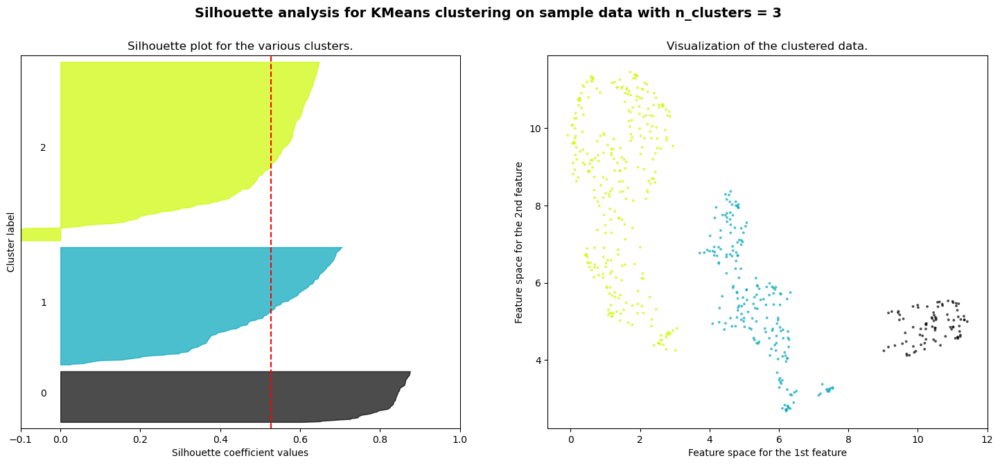

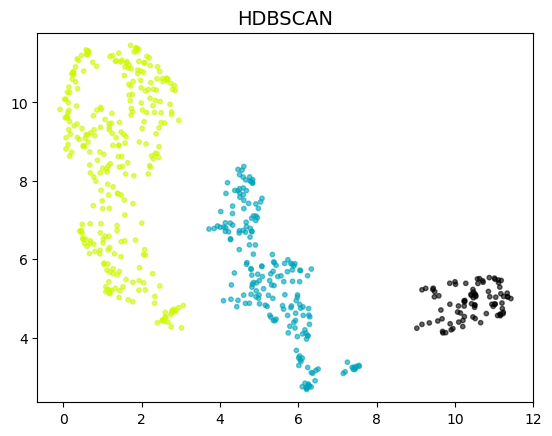


-------LFCC embeddings--------
For min_cluster_size=5, min_samples=1, n_clusters=4:                 average silhouette_score=0.5451570153236389
For min_cluster_size=5, min_samples=2, n_clusters=4:                 average silhouette_score=0.5451570153236389
For min_cluster_size=5, min_samples=3, n_clusters=4:                 average silhouette_score=0.5451570153236389
For min_cluster_size=5, min_samples=4, n_clusters=4:                 average silhouette_score=0.5451570153236389
For min_cluster_size=5, min_samples=5, n_clusters=4:                 average silhouette_score=0.5451570153236389
For min_cluster_size=5, min_samples=15, n_clusters=4:                 average silhouette_score=0.47393596172332764
For min_cluster_size=5, min_samples=25, n_clusters=3:                 average silhouette_score=0.7073869705200195

Best parameter combination: min_cluster_size=5, min_samples=25           with 3 clusters and silhouette score: 0.7073869705200195


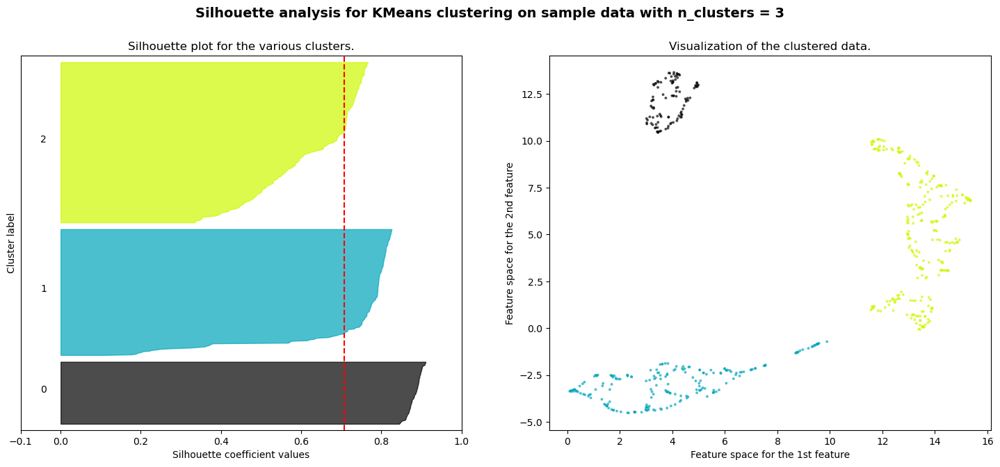

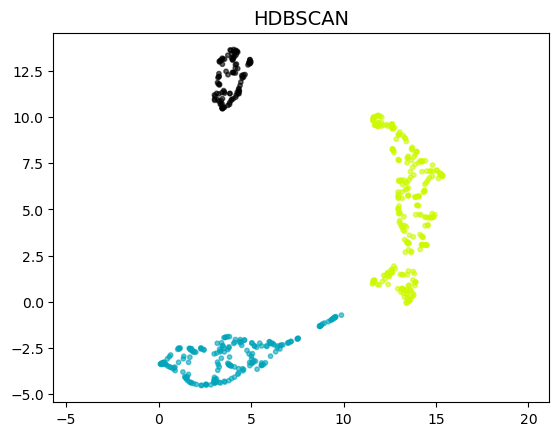


----Spectrogram embeddings----
For min_cluster_size=5, min_samples=1, n_clusters=2:                 average silhouette_score=0.6128489971160889
For min_cluster_size=5, min_samples=2, n_clusters=2:                 average silhouette_score=0.6128489971160889
For min_cluster_size=5, min_samples=3, n_clusters=2:                 average silhouette_score=0.6128489971160889
For min_cluster_size=5, min_samples=4, n_clusters=2:                 average silhouette_score=0.6128489971160889
For min_cluster_size=5, min_samples=5, n_clusters=2:                 average silhouette_score=0.6128489971160889
For min_cluster_size=5, min_samples=15, n_clusters=2:                 average silhouette_score=0.6128489971160889
For min_cluster_size=5, min_samples=25, n_clusters=2:                 average silhouette_score=0.6128489971160889

Best parameter combination: min_cluster_size=5, min_samples=1           with 2 clusters and silhouette score: 0.6128489971160889


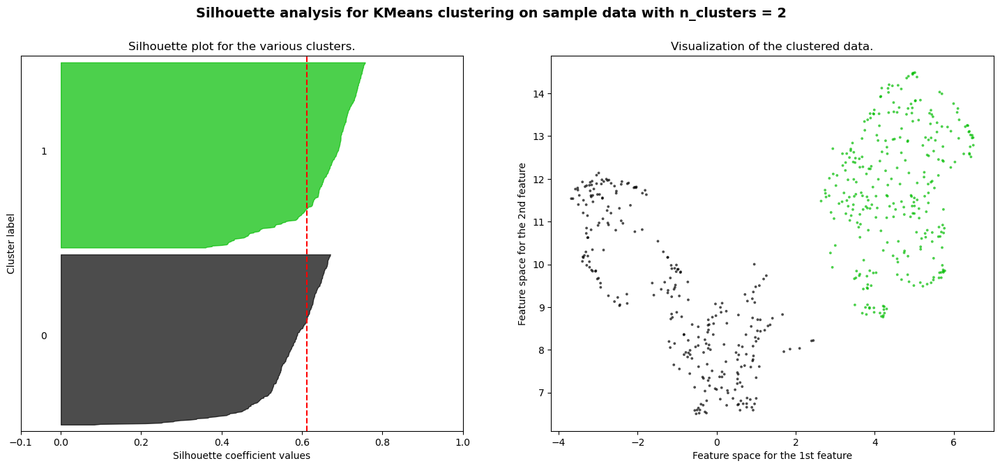

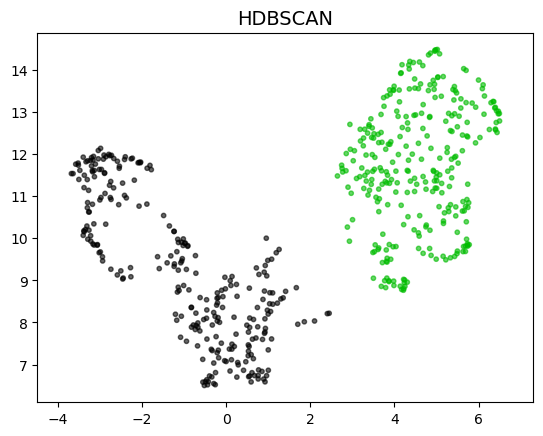


----VAE representations embeddings----
For min_cluster_size=5, min_samples=1, n_clusters=3:                 average silhouette_score=0.6922597289085388
For min_cluster_size=5, min_samples=2, n_clusters=3:                 average silhouette_score=0.6922597289085388
For min_cluster_size=5, min_samples=3, n_clusters=3:                 average silhouette_score=0.6922597289085388
For min_cluster_size=5, min_samples=4, n_clusters=3:                 average silhouette_score=0.6922597289085388
For min_cluster_size=5, min_samples=5, n_clusters=3:                 average silhouette_score=0.6922597289085388
For min_cluster_size=5, min_samples=15, n_clusters=3:                 average silhouette_score=0.4630366861820221
For min_cluster_size=5, min_samples=25, n_clusters=3:                 average silhouette_score=0.6922597289085388

Best parameter combination: min_cluster_size=5, min_samples=1           with 3 clusters and silhouette score: 0.6922597289085388


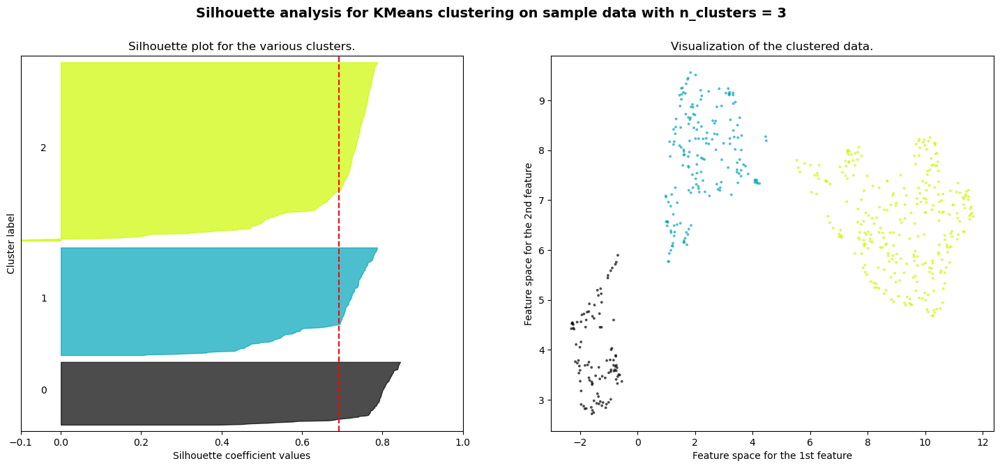

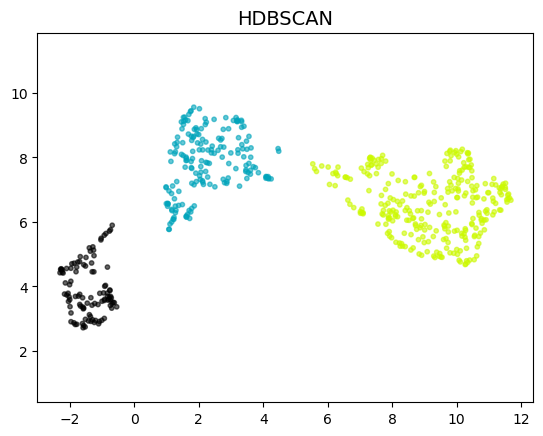

In [43]:
print("--------------PAF---------------")

print("\n--------PAF embeddings--------")
_, _, clusters_dict["PAFs"]["HDBSCAN"] = clustering.silhouette_analysis_hdbscan(embeddings_paf)

print("\n-------LFCC embeddings--------")
_, _, clusters_dict["LFCCs"]["HDBSCAN"] = clustering.silhouette_analysis_hdbscan(embeddings_lfcc)

print("\n----Spectrogram embeddings----")
_, _, clusters_dict["Spectrograms"]["HDBSCAN"] = clustering.silhouette_analysis_hdbscan(embeddings_spec)

print("\n----VAE representations embeddings----")
_, _, clusters_dict["VAE representations"]["HDBSCAN"] = clustering.silhouette_analysis_hdbscan(embeddings_vae)

#### Leiden clustering

--------------PAF---------------


100%|██████████| 570/570 [00:00<00:00, 101118.86it/s]


For resolution = 0.1 The average modularity is: 0.47090630712118653 N clusters: 2


100%|██████████| 570/570 [00:00<00:00, 171110.31it/s]


For resolution = 0.2 The average modularity is: 0.5620816766226343 N clusters: 3


100%|██████████| 570/570 [00:00<00:00, 185186.16it/s]


For resolution = 0.3 The average modularity is: 0.6467802023856634 N clusters: 4


100%|██████████| 570/570 [00:00<00:00, 203139.88it/s]


For resolution = 0.4 The average modularity is: 0.6467802023856634 N clusters: 4


100%|██████████| 570/570 [00:00<00:00, 192368.30it/s]


For resolution = 0.5 The average modularity is: 0.6723654688098694 N clusters: 5


100%|██████████| 570/570 [00:00<00:00, 209164.77it/s]


For resolution = 0.6 The average modularity is: 0.6724594380688564 N clusters: 5


100%|██████████| 570/570 [00:00<00:00, 200988.09it/s]


For resolution = 0.7 The average modularity is: 0.6722675972512736 N clusters: 5


100%|██████████| 570/570 [00:00<00:00, 194544.17it/s]


For resolution = 0.7999999999999999 The average modularity is: 0.6765339963316813 N clusters: 6


100%|██████████| 570/570 [00:00<00:00, 218533.21it/s]


For resolution = 0.8999999999999999 The average modularity is: 0.6765339963316813 N clusters: 6


100%|██████████| 570/570 [00:00<00:00, 219738.35it/s]


For resolution = 0.9999999999999999 The average modularity is: 0.6752730667520933 N clusters: 6


100%|██████████| 570/570 [00:00<00:00, 192958.30it/s]


For resolution = 1.0999999999999999 The average modularity is: 0.6935003234904304 N clusters: 8


100%|██████████| 570/570 [00:00<00:00, 182975.15it/s]


For resolution = 1.2 The average modularity is: 0.6964863835654299 N clusters: 8


100%|██████████| 570/570 [00:00<00:00, 216064.46it/s]


For resolution = 1.3 The average modularity is: 0.6923290054710713 N clusters: 8


100%|██████████| 570/570 [00:00<00:00, 181668.18it/s]


For resolution = 1.4 The average modularity is: 0.6923290054710713 N clusters: 8


100%|██████████| 570/570 [00:00<00:00, 205780.11it/s]


For resolution = 1.5 The average modularity is: 0.6771177395242491 N clusters: 10


100%|██████████| 570/570 [00:00<00:00, 165794.26it/s]


For resolution = 1.5999999999999999 The average modularity is: 0.6762574120137436 N clusters: 11


100%|██████████| 570/570 [00:00<00:00, 201972.91it/s]


For resolution = 1.7 The average modularity is: 0.6718810654455689 N clusters: 11


100%|██████████| 570/570 [00:00<00:00, 186224.75it/s]


For resolution = 1.8 The average modularity is: 0.6688354815610454 N clusters: 12


100%|██████████| 570/570 [00:00<00:00, 196494.89it/s]


For resolution = 1.9 The average modularity is: 0.6688354815610454 N clusters: 12


100%|██████████| 570/570 [00:00<00:00, 190771.89it/s]


For resolution = 2.0 The average modularity is: 0.658811133409966 N clusters: 13


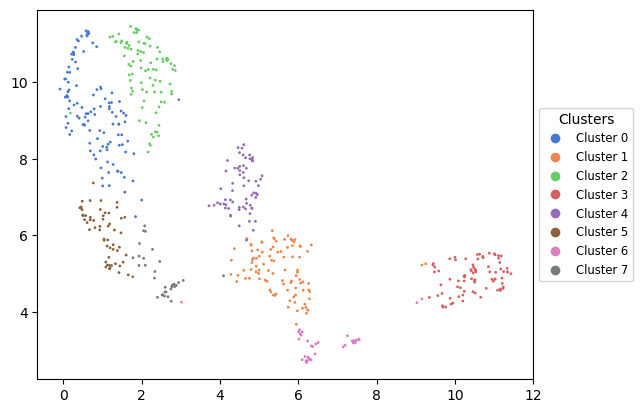

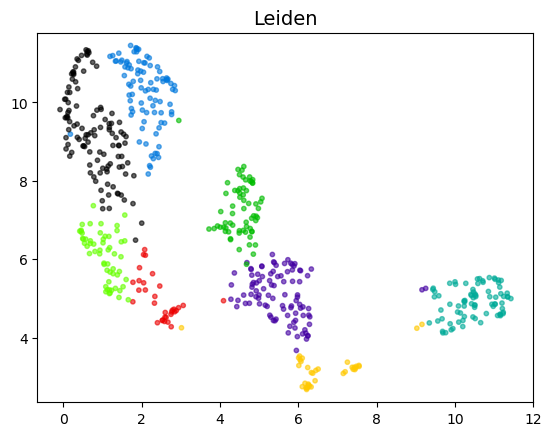

best score with 8 clusters and resolution parameter 1.2: 0.6964863835654299

----LFCCs----


100%|██████████| 570/570 [00:00<00:00, 142671.92it/s]


For resolution = 0.1 The average modularity is: 0.6073037543734021 N clusters: 3


100%|██████████| 570/570 [00:00<00:00, 208508.05it/s]


For resolution = 0.2 The average modularity is: 0.6140477996369369 N clusters: 3


100%|██████████| 570/570 [00:00<00:00, 211104.04it/s]


For resolution = 0.3 The average modularity is: 0.7095252934969003 N clusters: 5


100%|██████████| 570/570 [00:00<00:00, 212379.26it/s]


For resolution = 0.4 The average modularity is: 0.7379361389061627 N clusters: 5


100%|██████████| 570/570 [00:00<00:00, 224948.56it/s]


For resolution = 0.5 The average modularity is: 0.7654849215771259 N clusters: 7


100%|██████████| 570/570 [00:00<00:00, 213402.95it/s]


For resolution = 0.6 The average modularity is: 0.7648483677866346 N clusters: 7


100%|██████████| 570/570 [00:00<00:00, 191658.91it/s]


For resolution = 0.7 The average modularity is: 0.7731788430977192 N clusters: 8


100%|██████████| 570/570 [00:00<00:00, 221202.19it/s]


For resolution = 0.7999999999999999 The average modularity is: 0.7795175203045206 N clusters: 8


100%|██████████| 570/570 [00:00<00:00, 206455.38it/s]


For resolution = 0.8999999999999999 The average modularity is: 0.7810628466529733 N clusters: 8


100%|██████████| 570/570 [00:00<00:00, 213136.60it/s]


For resolution = 0.9999999999999999 The average modularity is: 0.7811644163667314 N clusters: 8


100%|██████████| 570/570 [00:00<00:00, 204828.07it/s]


For resolution = 1.0999999999999999 The average modularity is: 0.7806685573583081 N clusters: 9


100%|██████████| 570/570 [00:00<00:00, 212134.28it/s]


For resolution = 1.2 The average modularity is: 0.7883426140539318 N clusters: 10


100%|██████████| 570/570 [00:00<00:00, 204460.21it/s]


For resolution = 1.3 The average modularity is: 0.7919985898329783 N clusters: 11


100%|██████████| 570/570 [00:00<00:00, 225478.95it/s]


For resolution = 1.4 The average modularity is: 0.7913680661553634 N clusters: 11


100%|██████████| 570/570 [00:00<00:00, 194275.42it/s]


For resolution = 1.5 The average modularity is: 0.783477168799191 N clusters: 13


100%|██████████| 570/570 [00:00<00:00, 213479.17it/s]


For resolution = 1.5999999999999999 The average modularity is: 0.7841400886300965 N clusters: 13


100%|██████████| 570/570 [00:00<00:00, 211440.11it/s]


For resolution = 1.7 The average modularity is: 0.781546244998461 N clusters: 14


100%|██████████| 570/570 [00:00<00:00, 189186.78it/s]


For resolution = 1.8 The average modularity is: 0.7822753468885246 N clusters: 14


100%|██████████| 570/570 [00:00<00:00, 203503.00it/s]


For resolution = 1.9 The average modularity is: 0.7817062392824166 N clusters: 14


100%|██████████| 570/570 [00:00<00:00, 204442.73it/s]


For resolution = 2.0 The average modularity is: 0.7796674722520586 N clusters: 15


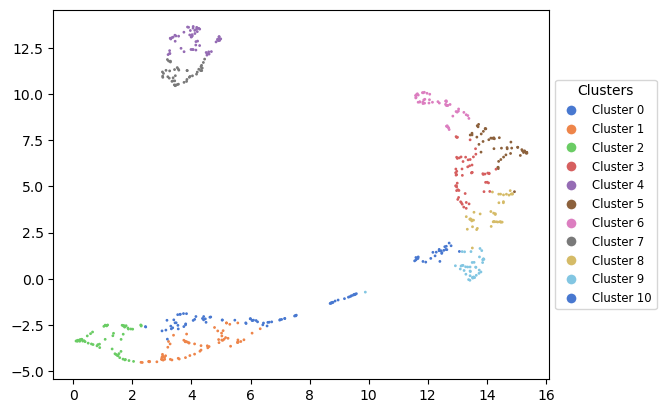

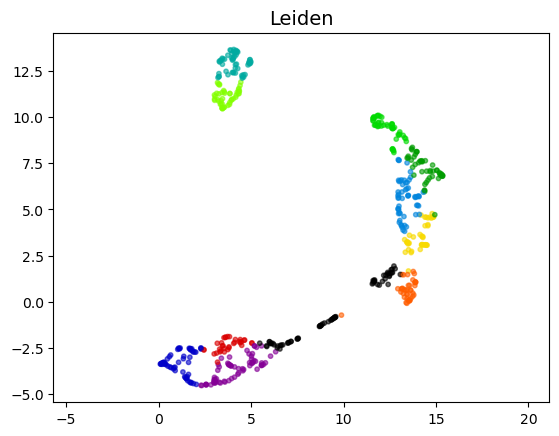

best score with 11 clusters and resolution parameter 1.3: 0.7919985898329783

----Spectrograms----


100%|██████████| 570/570 [00:00<00:00, 192756.05it/s]


For resolution = 0.1 The average modularity is: 0.47568827300079775 N clusters: 2


100%|██████████| 570/570 [00:00<00:00, 200348.05it/s]


For resolution = 0.2 The average modularity is: 0.554679296926527 N clusters: 3


100%|██████████| 570/570 [00:00<00:00, 201479.29it/s]


For resolution = 0.3 The average modularity is: 0.554679296926527 N clusters: 3


100%|██████████| 570/570 [00:00<00:00, 208471.68it/s]


For resolution = 0.4 The average modularity is: 0.5537009582226243 N clusters: 3


100%|██████████| 570/570 [00:00<00:00, 215402.58it/s]


For resolution = 0.5 The average modularity is: 0.5537009582226243 N clusters: 3


100%|██████████| 570/570 [00:00<00:00, 188679.13it/s]


For resolution = 0.6 The average modularity is: 0.5601840833286222 N clusters: 4


100%|██████████| 570/570 [00:00<00:00, 215596.83it/s]


For resolution = 0.7 The average modularity is: 0.559016934566994 N clusters: 5


100%|██████████| 570/570 [00:00<00:00, 194196.51it/s]

For resolution = 0.7999999999999999 The average modularity is: 0.6177249200695977 N clusters: 6



100%|██████████| 570/570 [00:00<00:00, 188233.47it/s]


For resolution = 0.8999999999999999 The average modularity is: 0.644815641861546 N clusters: 6


100%|██████████| 570/570 [00:00<00:00, 197844.53it/s]


For resolution = 0.9999999999999999 The average modularity is: 0.6454196738713953 N clusters: 6


100%|██████████| 570/570 [00:00<00:00, 203139.88it/s]


For resolution = 1.0999999999999999 The average modularity is: 0.6273721584663414 N clusters: 6


100%|██████████| 570/570 [00:00<00:00, 217143.80it/s]


For resolution = 1.2 The average modularity is: 0.6541465819938318 N clusters: 8


100%|██████████| 570/570 [00:00<00:00, 201836.49it/s]


For resolution = 1.3 The average modularity is: 0.6551524801979888 N clusters: 8


100%|██████████| 570/570 [00:00<00:00, 219134.12it/s]


For resolution = 1.4 The average modularity is: 0.6610261556146004 N clusters: 9


100%|██████████| 570/570 [00:00<00:00, 187819.41it/s]


For resolution = 1.5 The average modularity is: 0.6609422836539972 N clusters: 9


100%|██████████| 570/570 [00:00<00:00, 208726.50it/s]


For resolution = 1.5999999999999999 The average modularity is: 0.6445423474098784 N clusters: 11


100%|██████████| 570/570 [00:00<00:00, 214686.90it/s]


For resolution = 1.7 The average modularity is: 0.6424991912739244 N clusters: 11


100%|██████████| 570/570 [00:00<00:00, 176244.25it/s]


For resolution = 1.8 The average modularity is: 0.6476471488872558 N clusters: 11


100%|██████████| 570/570 [00:00<00:00, 211029.51it/s]


For resolution = 1.9 The average modularity is: 0.6435801282655264 N clusters: 11


100%|██████████| 570/570 [00:00<00:00, 179297.53it/s]


For resolution = 2.0 The average modularity is: 0.6417943982763931 N clusters: 11


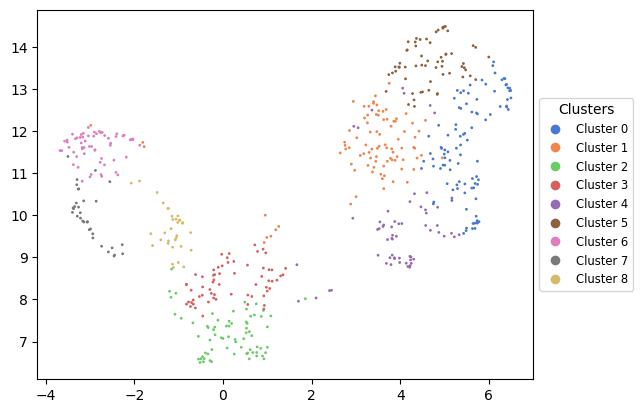

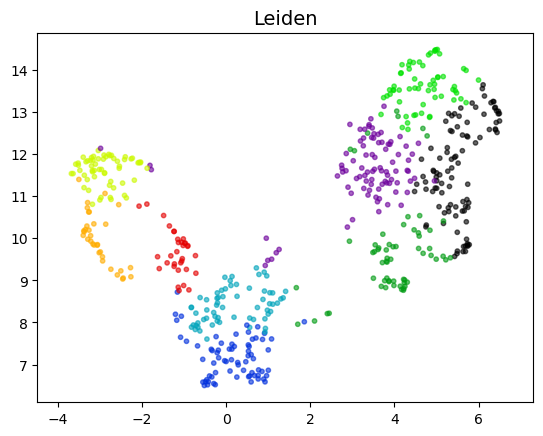

best score with 9 clusters and resolution parameter 1.4: 0.6610261556146004

----VAE representations----


100%|██████████| 570/570 [00:00<00:00, 146969.53it/s]


For resolution = 0.1 The average modularity is: 0.4860968131481588 N clusters: 2


100%|██████████| 570/570 [00:00<00:00, 189501.69it/s]


For resolution = 0.2 The average modularity is: 0.5889531786860636 N clusters: 3


100%|██████████| 570/570 [00:00<00:00, 187201.73it/s]


For resolution = 0.3 The average modularity is: 0.5889531786860636 N clusters: 3


100%|██████████| 570/570 [00:00<00:00, 201207.99it/s]


For resolution = 0.4 The average modularity is: 0.6311681380770221 N clusters: 4


100%|██████████| 570/570 [00:00<00:00, 212454.75it/s]


For resolution = 0.5 The average modularity is: 0.6311681380770221 N clusters: 4


100%|██████████| 570/570 [00:00<00:00, 189171.81it/s]


For resolution = 0.6 The average modularity is: 0.6800527320808285 N clusters: 5


100%|██████████| 570/570 [00:00<00:00, 187011.36it/s]


For resolution = 0.7 The average modularity is: 0.6907270840007286 N clusters: 6


100%|██████████| 570/570 [00:00<00:00, 189561.79it/s]

For resolution = 0.7999999999999999 The average modularity is: 0.6908882874479432 N clusters: 6



100%|██████████| 570/570 [00:00<00:00, 168945.89it/s]


For resolution = 0.8999999999999999 The average modularity is: 0.6908882874479432 N clusters: 6


100%|██████████| 570/570 [00:00<00:00, 178747.91it/s]


For resolution = 0.9999999999999999 The average modularity is: 0.6921324536278038 N clusters: 6


100%|██████████| 570/570 [00:00<00:00, 180953.17it/s]


For resolution = 1.0999999999999999 The average modularity is: 0.6921920245475846 N clusters: 7


100%|██████████| 570/570 [00:00<00:00, 205550.11it/s]


For resolution = 1.2 The average modularity is: 0.6917318594104307 N clusters: 9


100%|██████████| 570/570 [00:00<00:00, 212605.89it/s]


For resolution = 1.3 The average modularity is: 0.6924232809467277 N clusters: 9


100%|██████████| 570/570 [00:00<00:00, 191290.87it/s]


For resolution = 1.4 The average modularity is: 0.6856297542100865 N clusters: 10


100%|██████████| 570/570 [00:00<00:00, 186021.89it/s]


For resolution = 1.5 The average modularity is: 0.6854369476322384 N clusters: 10


100%|██████████| 570/570 [00:00<00:00, 213136.60it/s]


For resolution = 1.5999999999999999 The average modularity is: 0.6853861156651025 N clusters: 10


100%|██████████| 570/570 [00:00<00:00, 189366.60it/s]


For resolution = 1.7 The average modularity is: 0.6849219383044076 N clusters: 10


100%|██████████| 570/570 [00:00<00:00, 177513.61it/s]


For resolution = 1.8 The average modularity is: 0.6844105800214823 N clusters: 10


100%|██████████| 570/570 [00:00<00:00, 175159.59it/s]


For resolution = 1.9 The average modularity is: 0.680080291581083 N clusters: 11


100%|██████████| 570/570 [00:00<00:00, 213555.45it/s]


For resolution = 2.0 The average modularity is: 0.6789276763336913 N clusters: 11


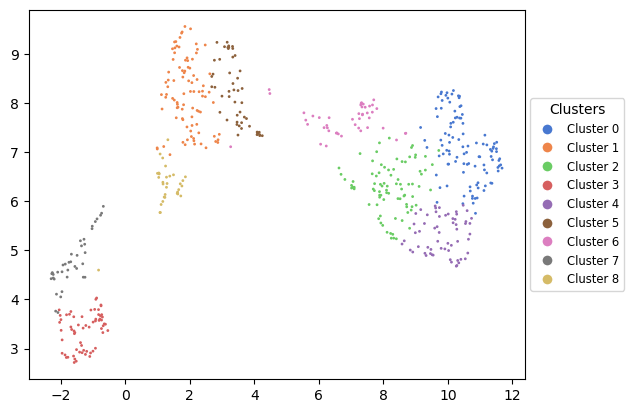

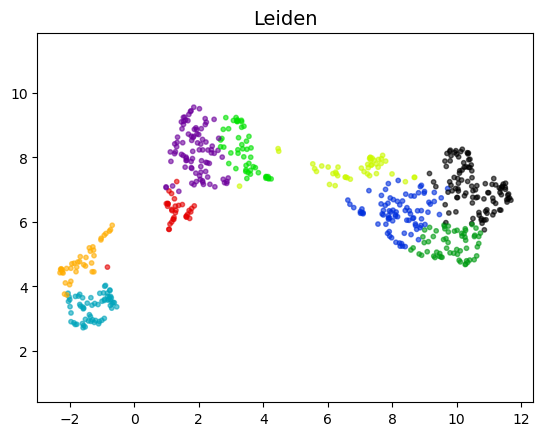

best score with 9 clusters and resolution parameter 1.3: 0.6924232809467277


In [44]:
print("--------------PAF---------------")
_, _, clusters_dict["PAFs"]["Leiden"], partition_paf = clustering.modularity_analysis_leiden(nn_results_paf, calls_df, "leiden_cluster_paf", embeddings=embeddings_paf, plot_every_step=False, plot_best_clustering=True)

print("\n----LFCCs----")
_, _, clusters_dict["LFCCs"]["Leiden"], partition_lfcc = clustering.modularity_analysis_leiden(nn_results_lfcc, calls_df, "leiden_cluster_lfcc", embeddings=embeddings_lfcc, plot_every_step=False, plot_best_clustering=True)

print("\n----Spectrograms----")
_, _, clusters_dict["Spectrograms"]["Leiden"], partition_spectrogram = clustering.modularity_analysis_leiden(nn_results_spec, calls_df, "leiden_cluster_spectrogram", embeddings=embeddings_spec, plot_every_step=False, plot_best_clustering=True)

print("\n----VAE representations----")
_, _, clusters_dict["VAE representations"]["Leiden"], partition_vae = clustering.modularity_analysis_leiden(nn_results_vae, calls_df, "leiden_cluster_vae", embeddings=embeddings_vae, plot_every_step=False, plot_best_clustering=True)

clusters_dict["PAFs"]["Modularity"] = partition_paf.modularity
clusters_dict["LFCCs"]["Modularity"] = partition_lfcc.modularity
clusters_dict["Spectrograms"]["Modularity"] = partition_spectrogram.modularity
clusters_dict["VAE representations"]["Modularity"] = partition_vae.modularity

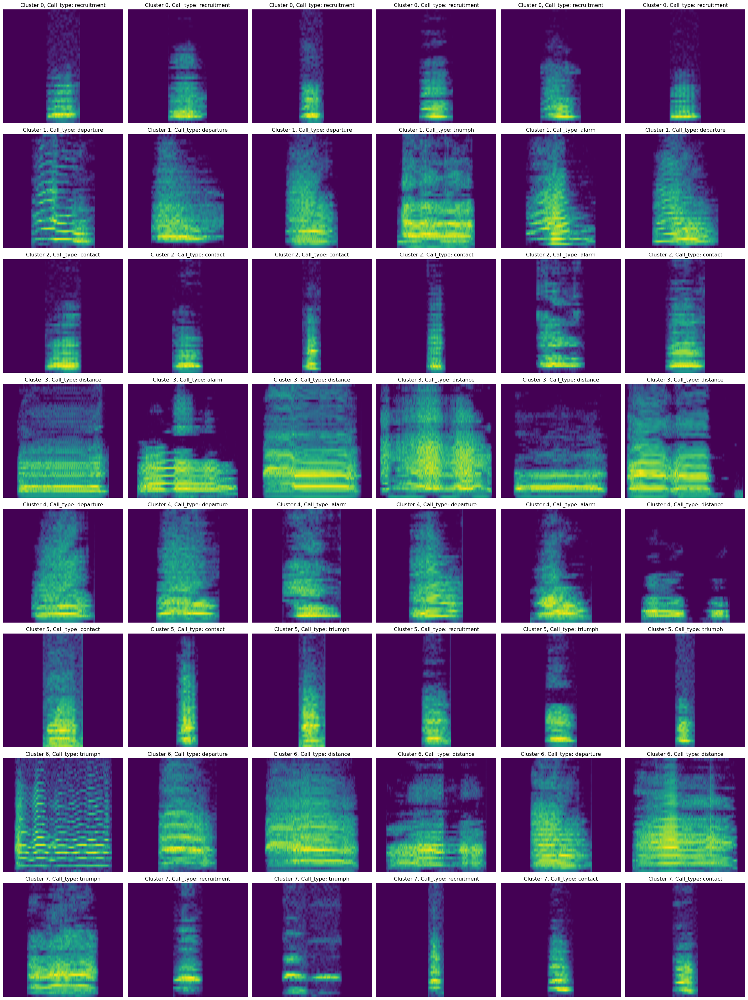

In [45]:
plotting.plot_cluster_examples("leiden_cluster_paf", np.unique(clusters_dict["PAFs"]["Leiden"]), calls_df)

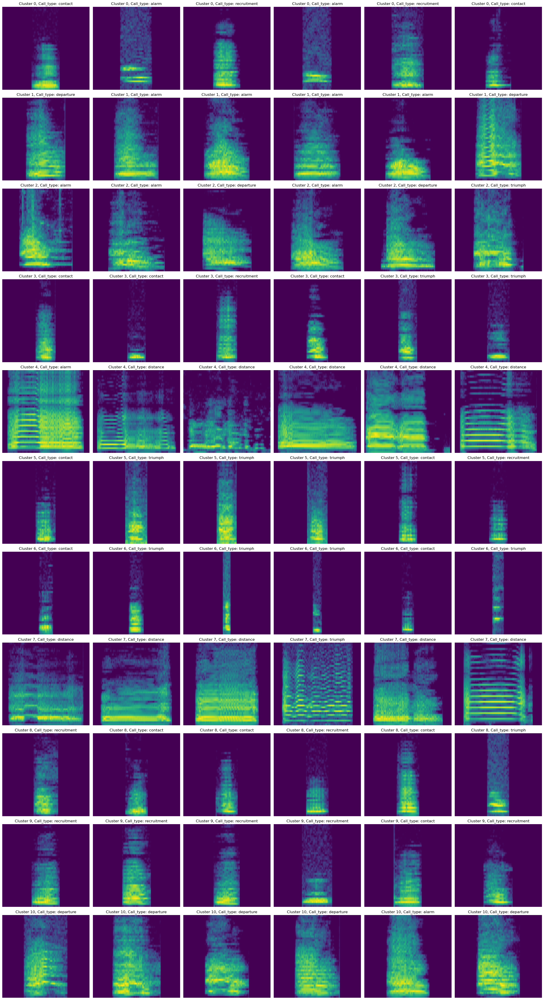

In [46]:
plotting.plot_cluster_examples("leiden_cluster_lfcc", np.unique(clusters_dict["LFCCs"]["Leiden"]), calls_df)

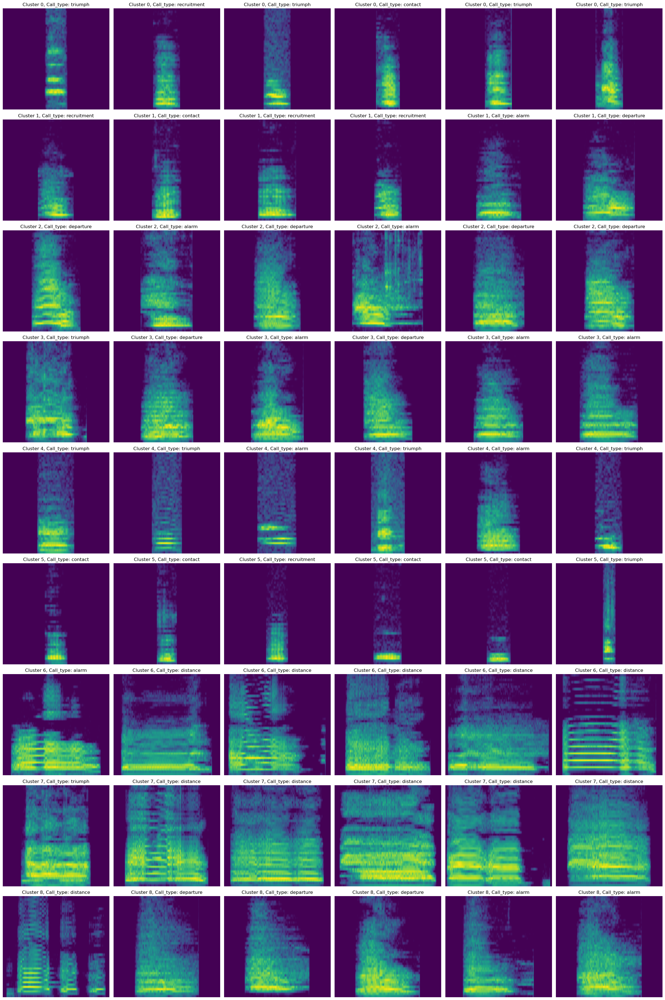

In [47]:
plotting.plot_cluster_examples("leiden_cluster_spectrogram", np.unique(clusters_dict["Spectrograms"]["Leiden"]), calls_df)

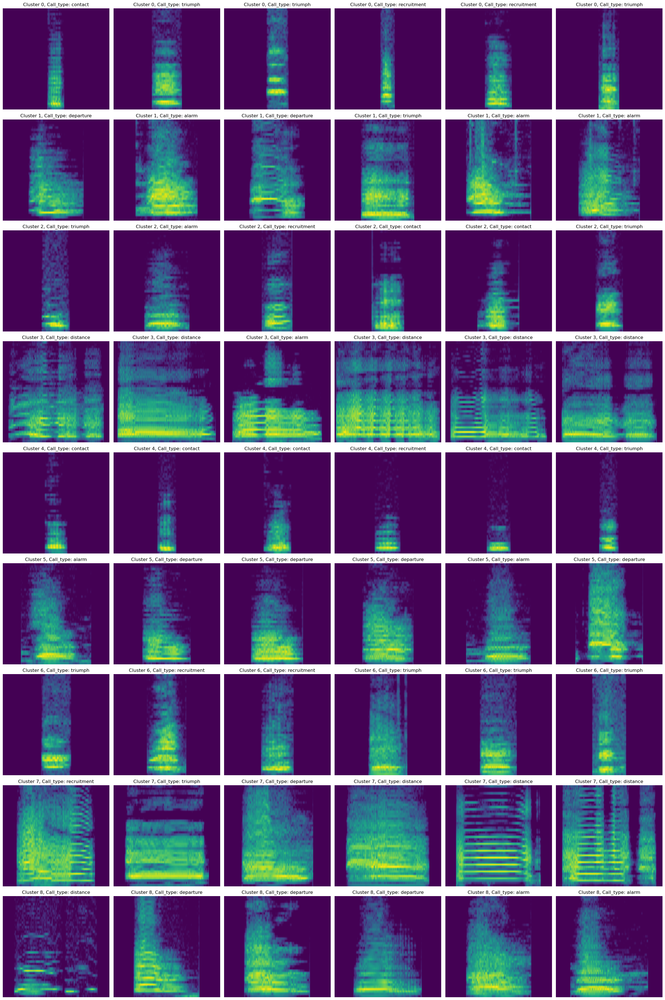

In [48]:
plotting.plot_cluster_examples("leiden_cluster_vae", np.unique(clusters_dict["VAE representations"]["Leiden"]), calls_df)

## Export cluster labels, Neirest Neighbour graphs and empeddings

In [49]:
# export clusters_dict
clusters_dict["PAFs"]["dataset"] = paf_scaled
clusters_dict["LFCCs"]["dataset"] = lfccs_scaled
clusters_dict["Spectrograms"]["dataset"] = spectrograms_scaled
clusters_dict["VAE representations"]["dataset"] = vae_df.drop(columns=["call_type", "track_ID", "goose_ID"])

with open(f"pickles_and_csvs/cluster_labels_embeddings_and_nn_graphs_L1_{SUBSET_SIZE}.pkl", "wb") as file:
    pickle.dump(clusters_dict, file, protocol=pickle.HIGHEST_PROTOCOL)

Tue Feb 11 10:53:21 2025 Worst tree score: 0.91052632
Tue Feb 11 10:53:21 2025 Mean tree score: 0.92163743
Tue Feb 11 10:53:21 2025 Best tree score: 0.94035088
Tue Feb 11 10:53:23 2025 Forward diversification reduced edges from 8550 to 3008
Tue Feb 11 10:53:26 2025 Reverse diversification reduced edges from 3008 to 3008
Tue Feb 11 10:53:28 2025 Degree pruning reduced edges from 3034 to 3034
Tue Feb 11 10:53:28 2025 Resorting data and graph based on tree order
Tue Feb 11 10:53:28 2025 Building and compiling search function
Tue Feb 11 10:53:30 2025 Worst tree score: 0.98421053
Tue Feb 11 10:53:30 2025 Mean tree score: 0.98888889
Tue Feb 11 10:53:30 2025 Best tree score: 0.99473684
Tue Feb 11 10:53:30 2025 Forward diversification reduced edges from 8550 to 2402
Tue Feb 11 10:53:30 2025 Reverse diversification reduced edges from 2402 to 2402
Tue Feb 11 10:53:30 2025 Degree pruning reduced edges from 2140 to 2140
Tue Feb 11 10:53:30 2025 Resorting data and graph based on tree order
Tue Feb 

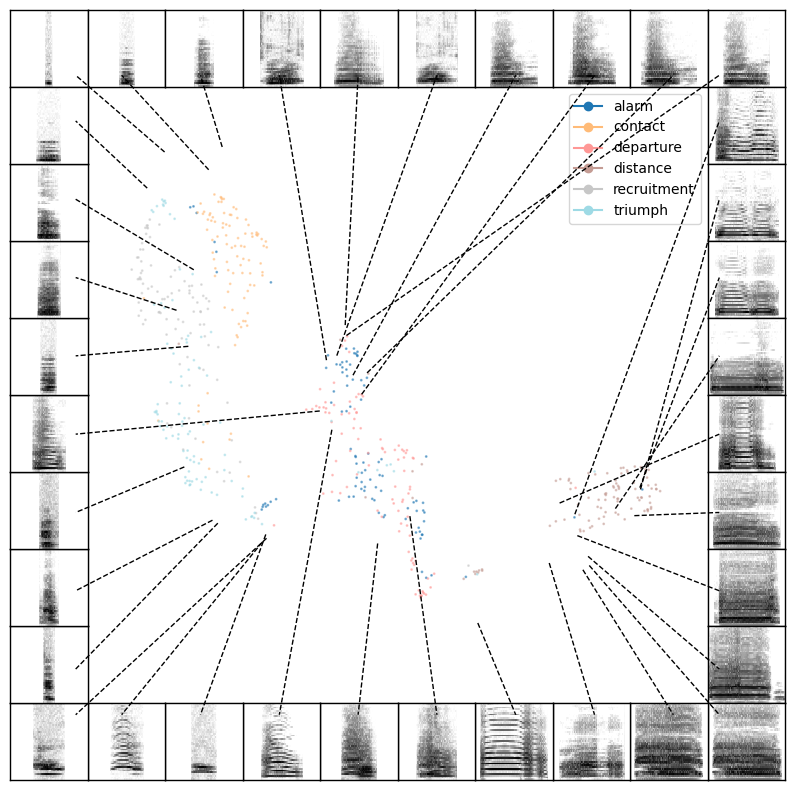

In [50]:
plotting.scatter_spec(embeddings_paf, calls_df["log_padded_spectrogram"], scatter_kwargs={"alpha": 0.5, "s": 1, "labels": calls_df["call_type"]})